In [1]:
import os,sys,time
import numpy as np
from scipy.io import wavfile
import sklearn

from IPython.display import Audio

import lib.audio as audio
import lib.midi as midi

import pyximport
pyximport.install(reload_support=True)
import lib.align as align

# DTW

In [2]:
fs=44100
window_size=2048
stride=512
cutoff=int(50*(window_size/2048.))

In [10]:
#record = 'MIDI-Unprocessed_R1_D2-13-20_mid--AUDIO-from_mp3_16_R1_2015_wav--1.wav'
record = 'bach_wtc/001_bwv864.wav'
record_midi = 'bach_wtc/001_bwv864.mid'
bounds = [0,int(66*fs)]
synth = 'wtc1p19.wav'
synth_midi = 'wtc1p19.mid'

In [11]:
#record = 'MIDI-Unprocessed_R1_D2-13-20_mid--AUDIO-from_mp3_16_R1_2015_wav--1.wav'
record = 'bach_wtc/001_bwv864.wav'
record_midi = 'bach_wtc/001_bwv864.mid'
bounds = [int(66*fs),-1]
synth = 'wtc1f19.wav'
synth_midi = 'wtc1f19.mid'

In [12]:
fs, data1 = wavfile.read(record)
data1 = data1[bounds[0]:bounds[1]] # just the prelude
frep1 = audio.featurize(data1,fs,audio.feature,window_size,stride=stride,normalize=False)

fs, data2 = wavfile.read(synth)
frep2 = audio.featurize(data2,fs,audio.feature,window_size,stride=stride,normalize=False)

/home/thickstn/.local/lib/python3.5/site-packages/scipy/io/wavfile.py:273: WavFileWarning: Chunk (non-data) not understood, skipping it.
  WavFileWarning)


In [13]:
Audio(data1[:5*fs,0],rate=fs)

In [14]:
Audio(data2[:5*fs,0],rate=fs)

In [15]:
# Align signals
start = time.time()
L,P = align.align(frep1[0:cutoff].T.astype(np.float32),frep2[0:cutoff].T.astype(np.float32))
end = time.time()
print('Elapsed time: ' + str(end - start))

Elapsed time: 27.45529532432556


In [16]:
# Find optimal path
path,costs = align.traceback(frep1[0:cutoff].T.astype(np.float32),frep2[0:cutoff].T.astype(np.float32),L)

In [17]:
path1 = np.array([x[0] for x in path])
path2 = np.array([x[1] for x in path])

In [18]:
# Find corresponding onsets on the performance
notes_onsets_offsets_2 = midi.load_midi(midifile)
for i, e in list(enumerate(notes_onsets_offsets_2)):
    notes_onsets_offsets_2[i] = (e[0], (e[1]*fs)/stride, (e[2]*fs)/stride)

notes_onsets_offsets_1 = []    
for note, onset, offset in notes_onsets_offsets_2:
    if (onset > path2[-1]) or (offset > path2[-1]):
        break
    sig2_onset_index = np.argmax(path2>=int(onset))
    sig2_offset_index = np.argmax(path2>=int(offset))
    sig1_onset = path1[sig2_onset_index]
    sig1_offset = path1[sig2_offset_index]
    notes_onsets_offsets_1.append((note, sig1_onset, sig1_offset))
notes_onsets_offsets_1 = np.array(notes_onsets_offsets_1)
print(notes_onsets_offsets_1)

length of midi file269.4351582416696
[[   69     0   108]
 [   68   199   227]
 [   73   227   255]
 ...
 [   69 12302 12524]
 [   61 12302 12524]
 [   45 12302 12524]]


In [19]:
# Find the correct onsets from the maestro midi file wtc1p19.mid
notes_onsets_offsets_correct = midi.load_midi(record_midi)

for i, e in list(enumerate(notes_onsets_offsets_correct)):
    notes_onsets_offsets_correct[i] = (e[0], (e[1]*fs)/stride, (e[2]*fs)/stride)

notes_onsets_offsets_correct_temp = []

for note, onset, offset in notes_onsets_offsets_correct:
    #print(onset,offset)
    if (onset - bounds[0]/stride < 0) or (offset - bounds[0]/stride > path2[-1]):
        continue
    notes_onsets_offsets_correct_temp.append((note, onset-bounds[0]/stride, offset-bounds[0]/stride))
notes_onsets_offsets_correct = np.array(notes_onsets_offsets_correct_temp)

notes_onsets_offsets_correct = notes_onsets_offsets_correct.astype(int)
print(notes_onsets_offsets_correct)

length of midi file212.3843750000017
[[   69    95   145]
 [   68   200   225]
 [   73   227   253]
 ...
 [   45 12313 12543]
 [   61 12313 12539]
 [   69 12313 12542]]


In [20]:
# Lets see how a perfect alignment would sound. You will here both onsets and offsets(offsets are hard to hear).
new_notes_onsets_offsets = notes_onsets_offsets_correct.copy()
for i, e in list(enumerate(new_notes_onsets_offsets)):
    new_notes_onsets_offsets[i] = (e[0], e[1]*stride, e[2]*stride)
out2 = audio.mark_notes_with_offsets(data1[:,0], new_notes_onsets_offsets)
wavfile.write('test.wav',fs,(.3*out2 + .7*data1[:,0]).astype(np.int16))
Audio(0.3*out2 + 0.7*data1[:,0],rate=fs)

In [21]:
# Now lets see how our alignment sounds. You will here both onsets and offsets(offsets are hard to hear).
new_notes_onsets_offsets = notes_onsets_offsets_1.copy()
for i, e in list(enumerate(new_notes_onsets_offsets)):
    new_notes_onsets_offsets[i] = (e[0], e[1]*stride, e[2]*stride)
out2 = audio.mark_notes_with_offsets(data1[:,0], new_notes_onsets_offsets)
wavfile.write('test.wav',fs,(.3*out2 + .7*data1[:,0]).astype(np.int16))
Audio(0.3*out2 + 0.7*data1[:,0],rate=fs)

# Evaluation

In [22]:
x = np.zeros((data1[:,0].shape[0], 128), dtype=bool)
y = np.zeros((data1[:,0].shape[0], 128), dtype=bool)

# Discretize maestro 
for note, onset, offset in notes_onsets_offsets_correct:
    onset = int(onset*stride)
    offset = int(offset*stride)
    for i in range(onset, offset):
        if (onset > x.shape[0] or offset > x.shape[0]):
            print("onset : " + str(onset) + " offset " + str(offset))
            break
        else:
            x[i][int(note)] = True  

# Discretize aligned midi         
for note, onset, offset in notes_onsets_offsets_1:
    onset = int(onset*stride)
    offset = int(offset*stride)
    for i in range(onset, offset):
        if (onset > y.shape[0] or offset > y.shape[0]):
            print("onset : " + str(onset) + " offset " + str(offset))
            break
        y[i][int(note)] = True

# Error conditions :
# 1) Something is playing in maestro and nothing is playing in alignment
# 2) Something is playing in alignment and nothing is playing in maestro
# This can be efficiently calculated using xor.

z = np.logical_xor(x[::512], y[::512])
print("Alignment Error: ", np.sum(z)) # total number of errors
print("Errors per second: ", np.sum(z)/(44100/512.)) # total number of errors
print("Errors per frame: ", np.sum(z)/len(z)) # total number of errors

Alignment Error:  7994
Errors per second:  92.81015873015873
Errors per frame:  0.6328873406697807


white means no mistake
red means playing when not supposed to
orange means not playing when supposed to
black means playing when supposed to


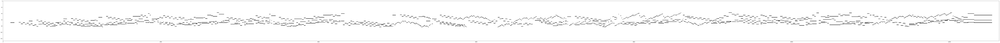

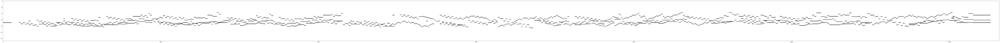

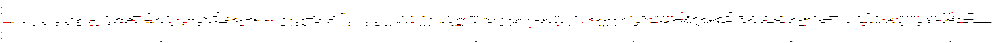

In [23]:
import matplotlib.pyplot as plt
from matplotlib import colors
from matplotlib.pyplot import figure
import numpy as np
            
def plotColorMap(x, y, figsize):
    print("white means no mistake")
    print("red means playing when not supposed to")
    print("orange means not playing when supposed to")
    print("black means playing when supposed to")
    cmap = colors.ListedColormap(['white','red','orange','black'])
    bounds = [0,1,2,3,4]
    norm = colors.BoundaryNorm(bounds, cmap.N)
    plt.figure(figsize=figsize)
    plt.imshow(np.transpose(x[::512]), interpolation='none', cmap='Greys', aspect=4)
    plt.figure(figsize=figsize)
    plt.imshow(np.transpose(y[::512]), interpolation='none', cmap='Greys', aspect=4)
    plt.figure(figsize=figsize)
    plt.imshow(np.transpose(x[::512])*2 + np.transpose(y[::512]), interpolation='none', cmap=cmap, aspect=4, norm=norm)
    
plotColorMap(x, y, (200, 20))

## Miscellaneous evaluators

In [21]:
# onsets_correct : The onsets from the maestro midi file
# onsets_predicted : The onsets generated from alignment
def evaluate_alignment(onsets_correct, onsets_predicted):
    score = 0
    for correct_onset in onsets_correct:
        found = False
        for predicted_onset in onsets_predicted:
            diff = abs(predicted_onset - correct_onset)
            if diff < 4:
                score = score + 1
                found = True
                break
        if found == False:
            print('incorrect onset : ' + str(correct_onset))
    return score

In [22]:
evaluate_alignment(onsets_correct, onsets_sig1)

NameError: name 'onsets_correct' is not defined